In [1]:
from spmf import Spmf
import numpy as np
import pandas as pd
import os
import re
import matplotlib.pyplot as plt
import ast
#pd.options.plotting.backend = "plotly"
import plotly.express as px
# from chart_studio import plotly
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.subplots as sp
from sklearn.feature_extraction.text import CountVectorizer
pd.options.display.max_colwidth = None
pd.set_option('display.max_rows', 70)
from pandas.plotting import table 
#import nltk

import nltk
import seaborn as sns
%matplotlib inline
import random
from sklearn.cluster import MiniBatchKMeans
from sklearn.decomposition import NMF
import pickle

## Union Frequent apps we found for session length grouped 

In [2]:
with open('frequent_apps_session_length.txt','rb') as f:
    freuqent_apps = pickle.load(f)

## Reading the data

In [3]:
col_list1 = ["user_id", "package_name",'session','user_median_session_length']
data_length1_session = pd.read_csv("data_length1_session_grouped.csv", usecols=col_list1)

In [4]:
col_list = ["user_id", "package_name",'session','user_median_session_length']
data_length2_session = pd.read_csv("data_length2_session_grouped.csv", usecols=col_list)

#data_length2_session['group']='group2'


In [5]:
col_list2 = ["user_id", "package_name",'session','user_median_session_length']
data_length_other_session = pd.read_csv("data_length_other_session_grouped.csv", usecols=col_list2)

#data_length_other_session['group']='group3'

## basic data analyse

In [4]:
data_length1_session[data_length1_session.user_id==1]

,user_id,package_name,session,user_median_session_length
0,1,com.sonymobile.moviecreator.rmm,0,1.0
1,1,com.yingwen.photographertoolspro,1,1.0
2,1,net.osmand.plus,1,1.0
3,1,com.android.phone,1,1.0
4,1,com.sonyericsson.album,2,1.0
...,...,...,...,...
21651,1,com.ebay.mobile,9943,1.0
21652,1,com.facebook.katana,9943,1.0
21653,1,com.facebook.katana,9944,1.0
21654,1,com.android.chrome,9945,1.0


In [5]:
data_length1_session.shape[0]

23616360

In [ ]:
data_length2_session.groupby('user_id').session.nunique().sum()

In [ ]:
data_length2_session.groupby('user_id').session.nunique()

In [ ]:
data_length_other_session.groupby('user_id').session.nunique().sum()

In [ ]:
data_length1_session.user_id.nunique()

In [ ]:
data_length2_session.shape[0]

In [ ]:
data_length2_session.describe()

In [ ]:
data_length2_session.user_id.nunique()

In [ ]:
data_length2_session.session.nunique()

In [ ]:
data_length_other_session.shape[0]

In [ ]:
data_length_other_session.session.nunique()

In [ ]:
data_length_other_session.user_id.nunique()

In [4]:
len(freuqent_apps)

95

## Transition matrix for group 1

In [6]:
# add padding first 
data_length1_session['start']=data_length1_session.groupby('user_id').session.shift(1)!=data_length1_session.session

data_length1_session['end']=data_length1_session.groupby('user_id').session.shift(-1)!=data_length1_session.session

user_corpus_length1_session=data_length1_session.groupby(['user_id','session']).package_name.apply(' '.join)

user_corpus_length1_session_with_start_end='start '+user_corpus_length1_session+ ' end'

In [7]:
frequent_apps_without_start_end=set(freuqent_apps)
frequent_apps_without_start_end.remove("start")
frequent_apps_without_start_end.remove("end")

df_frequent_app_count = data_length1_session[data_length1_session.package_name.apply(lambda l : l in frequent_apps_without_start_end)].groupby(['package_name'])\
                            .agg({'session':'size'})\
                            .rename(columns={'session':'app_count'})

data_length1_session['next_app'] = data_length1_session.groupby(['user_id','session']).package_name.shift(-1).fillna("end")

df_next_app_count=data_length1_session[data_length1_session.package_name.isin(frequent_apps_without_start_end)].groupby(['package_name','next_app'])\
                            .agg({'session':'size'})\
                            .rename(columns = {'session':'next_count'})

frequent_apps_without_start=set(freuqent_apps)
frequent_apps_without_start.remove("start")

df_numerator = df_next_app_count[df_next_app_count.index.get_level_values('next_app')\
                                 .isin(frequent_apps_without_start)].reset_index()

df_frequent_app_count=df_frequent_app_count\
                .append(pd.DataFrame(data_length1_session.start.sum(),columns=['app_count'],index=['start']))

df_frequent_app_count=df_frequent_app_count.reset_index()

start_numerator=data_length1_session[(data_length1_session.start)&(data_length1_session.package_name.isin(frequent_apps_without_start_end))].groupby(["package_name"]).agg({'session':'size'})\
                            .rename(columns = {'session':'next_count'}).reset_index().rename(columns = {'package_name':'next_app'})
start_numerator['package_name']='start'

df_numerator=df_numerator.append(start_numerator)

df_frequent_app_count=df_frequent_app_count.rename(columns={'index':'package_name'})

df_transaction_s1 = df_numerator.merge(df_frequent_app_count, on='package_name')


###

####
df_transaction_s1['probability'] =df_transaction_s1.next_count/df_transaction_s1.app_count

df_transaction_s1.drop(['next_count', 'app_count'], axis=1, inplace=True)

transitions_for_top=df_transaction_s1[(df_transaction_s1.package_name.isin(set(freuqent_apps)))&(df_transaction_s1.next_app.isin(set(freuqent_apps)))]  
transitions_for_top['probability']=transitions_for_top.groupby('package_name').probability.transform(lambda x: x  / x.sum())


In [8]:
transitions_for_top

,package_name,next_app,probability
0,bbc.mobile.news.uk,bbc.mobile.weather,0.014689
1,bbc.mobile.news.uk,co.uk.Nationwide.Mobile,0.000144
2,bbc.mobile.news.uk,com.accuweather.android,0.000224
3,bbc.mobile.news.uk,com.amazon.kindle,0.001097
4,bbc.mobile.news.uk,com.amazon.mShop.android.shopping,0.002411
...,...,...,...
7817,start,jp.naver.line.android,0.000843
7818,start,kik.android,0.001856
7819,start,org.telegram.messenger,0.000376
7820,start,uk.co.bbc.android.iplayerradio,0.002707


In [9]:
Transaction_matrix_nomalized = transitions_for_top.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

Transaction_matrix_nomalized=Transaction_matrix_nomalized.fillna(0)

In [10]:
Transaction_matrix = df_transaction_s1.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

Transaction_matrix=Transaction_matrix.fillna(0)

### The matrix visualization 

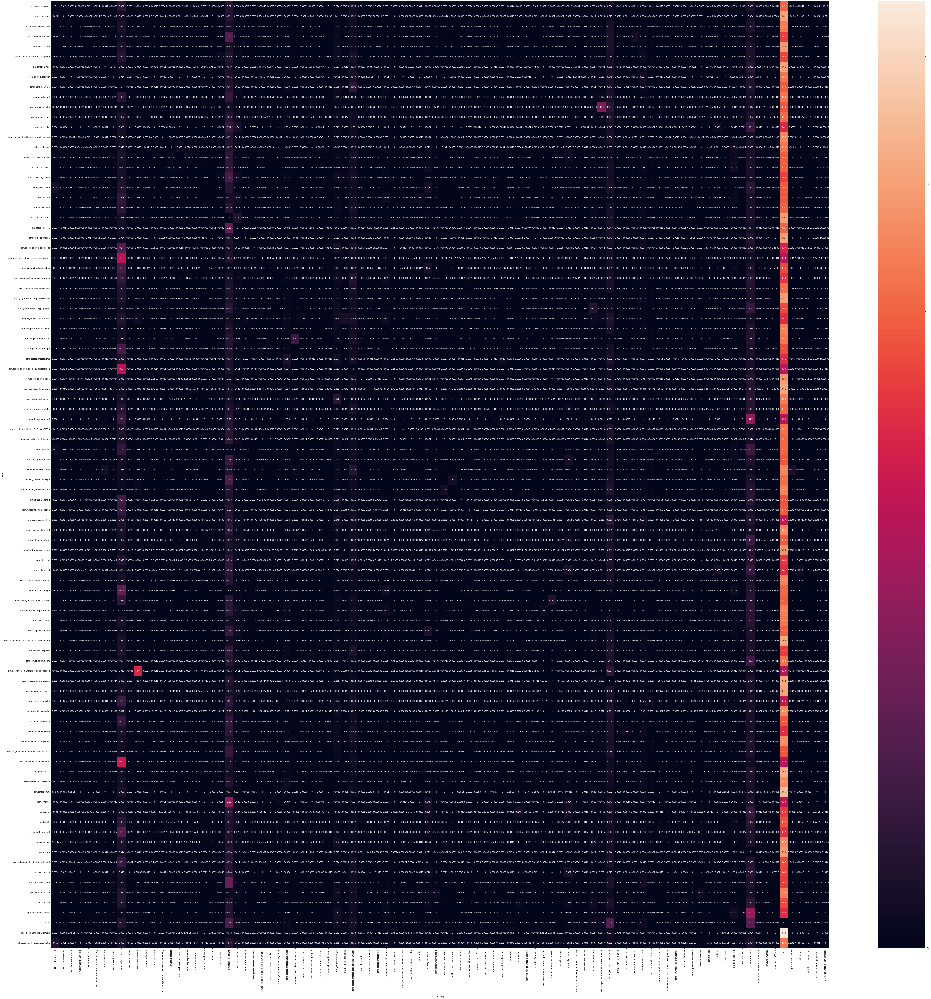

In [11]:
fig, ax = plt.subplots(figsize=(90,90))  
ax = sns.heatmap(Transaction_matrix_nomalized, annot=True)
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('output_length1_nomalized_test.png')
plt.show()



In [10]:
df = np.log10(Transaction_matrix_nomalized)
df = df.replace([np.inf, -np.inf], np.nan)

In [13]:
test = Transaction_matrix_nomalized.replace([0], np.nan)

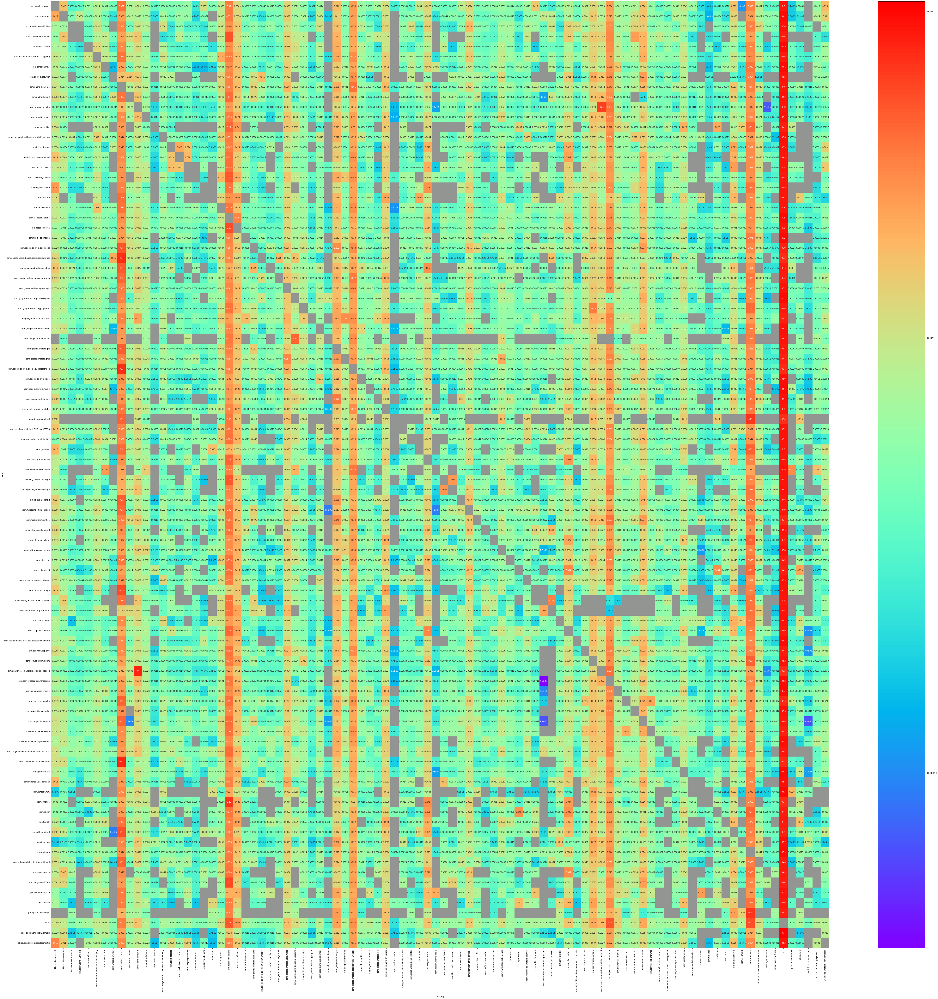

In [14]:
#fig, ax = plt.subplots(figsize=(70,70))  
plt.figure(figsize=(90, 90))
ax = sns.heatmap(df, cmap=sns.color_palette("rainbow", as_cmap=True),cbar=False,annot=Transaction_matrix_nomalized)
ax.set_facecolor('xkcd:grey')
cbar = ax.figure.colorbar(ax.collections[0], ticks=[-5.226761393206698,-2.35303706197875,-0.19464998766607708])
cbar.ax.set_yticklabels(['0.0000059','0.00443','0.63877'])
#'7.6e-06','0.00264',
#vmin=,vmax=,
#fmt=".1f"
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length1_nomalized_test.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

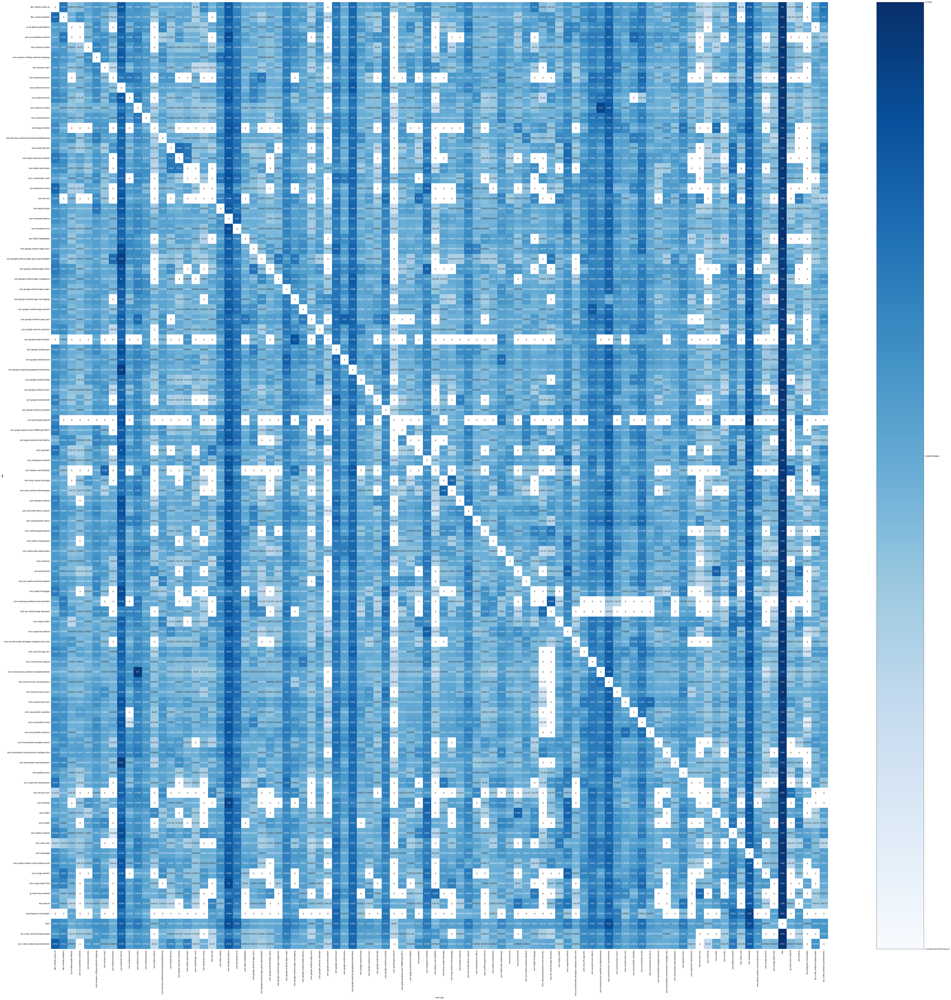

In [138]:
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(90,90))
sns.heatmap(
    np.where(df.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df,
    #ax=ax[0, 0],
    cbar=False,
    annot=Transaction_matrix_nomalized,
    #fmt="",
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
cbar = ax.figure.colorbar(ax.collections[1], ticks=[-6.3839415084117785,-3.12758357364,-0.12877436113948487])
cbar.ax.set_yticklabels(['4.131031357419725e-07','0.0007454464','0.7434'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length1_nomalized_matrix.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

In [16]:
np_Transaction_matrix_nomalized = Transaction_matrix_nomalized.to_numpy()

In [17]:

np.amin( np_Transaction_matrix_nomalized[np_Transaction_matrix_nomalized>0])   

4.131031357419725e-07

In [18]:
np.mean( np_Transaction_matrix_nomalized[np_Transaction_matrix_nomalized>0])

0.012017386857581181

In [19]:
np.amax( np_Transaction_matrix_nomalized) 

0.7434052757793764

In [20]:
np.amax( df.fillna(-10).to_numpy()) 

-0.12877436113948487

## Extract meaningful matrix for individual analyse 

In [36]:
df[['com.accuweather.android','bbc.mobile.news.uk']]

next_app,com.accuweather.android,bbc.mobile.news.uk
package_name,,
bbc.mobile.news.uk,-3.649262,NaN
bbc.mobile.weather,-2.446244,-1.570515
co.uk.Nationwide.Mobile,NaN,-2.764083
com.accuweather.android,NaN,-2.985726
com.amazon.kindle,-4.218325,-2.720015
...,...,...
kik.android,NaN,-2.758837
org.telegram.messenger,NaN,NaN
start,-2.952812,-2.311001


In [43]:
Transaction_matrix_nomalized.loc[['bbc.mobile.weather', 'com.accuweather.android']\
       , ['com.facebook.katana','com.google.android.googlequicksearchbox']]

next_app,com.facebook.katana,com.google.android.googlequicksearchbox
package_name,,
bbc.mobile.weather,0.071524,0.032334
com.accuweather.android,0.164600,0.029223


In [30]:
Transaction_matrix_nomalized_noend =Transaction_matrix_nomalized.drop(['end'], axis=1)

In [47]:
df_noend=df.drop(['end'], axis=1)

In [153]:
Transaction_matrix_nomalized_noend['counts_7']=Transaction_matrix_nomalized_noend.ge(0.07).sum(axis=1)
#df_noend['counts_03']=df_noend.ge(0.1).sum(axis=1)

In [159]:
Transaction_matrix_nomalized_noend_7_1=Transaction_matrix_nomalized_noend[Transaction_matrix_nomalized_noend.counts_7>1]

In [160]:
Transaction_matrix_nomalized_noend_7_1[Transaction_matrix_nomalized_noend_7_1<0.01] = 0

<ipython-input-160-f7c5a9d552cc>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Transaction_matrix_nomalized_noend_7_1[Transaction_matrix_nomalized_noend_7_1<0.01] = 0
/home/s165317/.local/lib/python3.8/site-packages/pandas/core/frame.py:3718: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._where(-key, value, inplace=True)


In [167]:
Transaction_matrix_nomalized_noend_7_1 =Transaction_matrix_nomalized_noend_7_1.drop(['counts_7'],axis=1)

In [168]:
df_noend_7_1 = np.log10(Transaction_matrix_nomalized_noend_7_1)


### Start and End matrix 

making start and end row 

In [81]:
end = Transaction_matrix_nomalized.loc[:,['end']]
start_row = Transaction_matrix_nomalized.loc[['start'],:].T.sort_values(["start"], ascending=False)

In [82]:
 np.max(df.loc[['start'],:].T.sort_values(["start"], ascending=False))

package_name
start   -0.769402
dtype: float64

In [83]:
 np.max(df.loc[['start'],:].T.sort_values(["start"], ascending=False))

package_name
start   -0.769402
dtype: float64

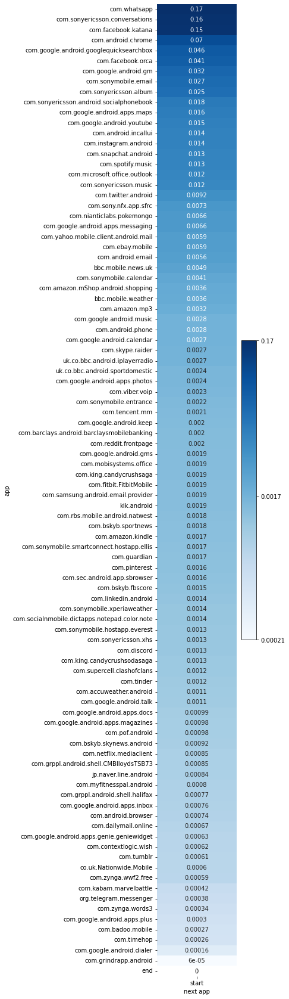

In [84]:
fig, ax = plt.subplots(figsize=(3,30))
sns.heatmap(
    np.where(df.loc[['start'],:].T.sort_values(["start"], ascending=False).isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df.loc[['start'],:].T.sort_values(["start"], ascending=False), "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df.loc[['start'],:].T.sort_values(["start"], ascending=False),
    #ax=ax[0, 0],
    cbar=False,
    annot=start_row,
    #fmt="",
    vmin=-4.220753, vmax=-0.769402,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
cbar = ax.figure.colorbar(ax.collections[1], ticks=[-4.220753,-2.568269,-0.769402])
cbar.ax.set_yticklabels(['0.00021','0.0017','0.17'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length1_nomalized_start.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

In [85]:
start = Transaction_matrix_nomalized.loc[['start'],:].T

In [86]:
start.index

Index(['bbc.mobile.news.uk', 'bbc.mobile.weather', 'co.uk.Nationwide.Mobile',
       'com.accuweather.android', 'com.amazon.kindle',
       'com.amazon.mShop.android.shopping', 'com.amazon.mp3',
       'com.android.browser', 'com.android.chrome', 'com.android.email',
       'com.android.incallui', 'com.android.phone', 'com.badoo.mobile',
       'com.barclays.android.barclaysmobilebanking', 'com.bskyb.fbscore',
       'com.bskyb.skynews.android', 'com.bskyb.sportnews',
       'com.contextlogic.wish', 'com.dailymail.online', 'com.discord',
       'com.ebay.mobile', 'com.facebook.katana', 'com.facebook.orca',
       'com.fitbit.FitbitMobile', 'com.google.android.apps.docs',
       'com.google.android.apps.genie.geniewidget',
       'com.google.android.apps.inbox', 'com.google.android.apps.magazines',
       'com.google.android.apps.maps', 'com.google.android.apps.messaging',
       'com.google.android.apps.photos', 'com.google.android.apps.plus',
       'com.google.android.calendar', 'com

In [47]:
np.mean(df.loc[:,['end']].sort_values(["end"],ascending=False))

next_app
end   -0.30676
dtype: float64

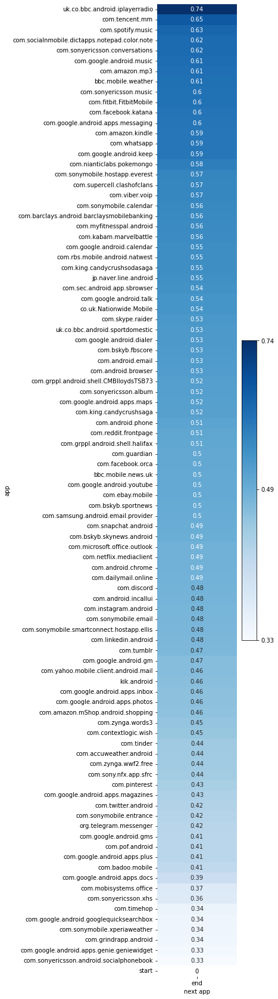

In [87]:
fig, ax = plt.subplots(figsize=(3,30))
sns.heatmap(
    np.where(df.loc[:,['end']].sort_values(["end"], ascending=False).isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df.loc[:,['end']].sort_values(["end"],ascending=False), "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df.loc[:,['end']].sort_values(["end"],ascending=False),
    #ax=ax[0, 0],
    cbar=False,
    annot=Transaction_matrix_nomalized.loc[:,['end']].sort_values(["end"],ascending=False),
    #fmt="",
    vmin=-0.487273, vmax=-0.128774,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
cbar = ax.figure.colorbar(ax.collections[1],ticks=[-0.487273,-0.30676,-0.128774])
cbar.ax.set_yticklabels(['0.33','0.49','0.74'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length1_nomalized_end.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

## Highest frequent 'next app'

In [88]:
high_df = df.loc[:,['com.android.chrome','com.facebook.katana','com.google.android.gm'
                      ,'com.facebook.orca','com.google.android.googlequicksearchbox',
                    'com.sonyericsson.conversations','com.whatsapp' ]]

In [89]:
high_norm = Transaction_matrix_nomalized.loc[:,['com.android.chrome','com.facebook.katana','com.google.android.gm'
                      ,'com.facebook.orca','com.google.android.googlequicksearchbox',
                    'com.sonyericsson.conversations','com.whatsapp' ]]

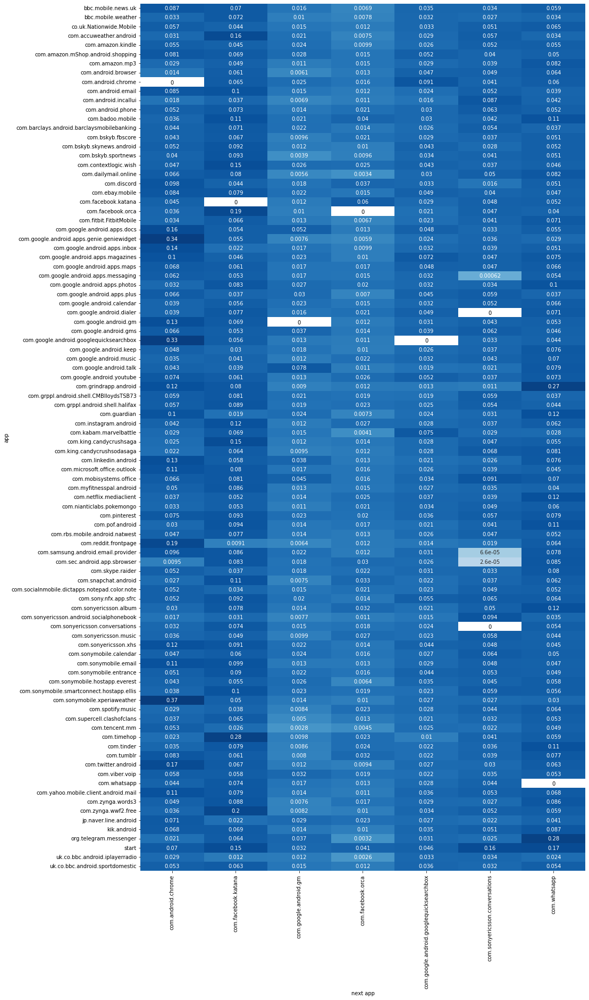

In [90]:
fig, ax = plt.subplots(figsize=(15,30))
sns.heatmap(
    np.where(high_df.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(high_df, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    high_df,
    #ax=ax[0, 0],
    cbar=False,
    annot=high_norm,
    #fmt="",
    vmin=-6.3839415084117785, vmax=-0.12877436113948487,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
#cbar = ax.figure.colorbar(ax.collections[1], ticks=[-6.3839415084117785,-2.570574812673693,-0.12877436113948487])
#cbar.ax.set_yticklabels(['4.131031357419725e-07','0.01202','0.7434'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length1_nomalized_high_next_app.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

## Highest data point 

In [32]:
Transaction_matrix_nomalized_noend['com.sonyericsson.conversations'].nlargest(n=1)

NameError: name 'Transaction_matrix_nomalized_noend' is not defined

In [293]:
Transaction_matrix_nomalized_noend['bbc.mobile.news.uk'].nlargest(n=1)

package_name
uk.co.bbc.android.sportdomestic    0.056165
Name: bbc.mobile.news.uk, dtype: float64

In [294]:

Transaction_matrix_nomalized_noend['bbc.mobile.weather'].nlargest(n=1)

package_name
com.zynga.words3    0.014721
Name: bbc.mobile.weather, dtype: float64

In [32]:
Transaction_matrix_nomalized_noend.stack().nlargest(20)

package_name                               next_app                                
com.sonyericsson.android.socialphonebook   com.android.incallui                        0.399911
com.sonymobile.xperiaweather               com.android.chrome                          0.369251
com.google.android.apps.genie.geniewidget  com.android.chrome                          0.336942
com.google.android.googlequicksearchbox    com.android.chrome                          0.333120
org.telegram.messenger                     com.whatsapp                                0.280248
com.timehop                                com.facebook.katana                         0.278774
com.grindrapp.android                      com.whatsapp                                0.270823
com.android.incallui                       com.sonyericsson.android.socialphonebook    0.234634
com.zynga.wwf2.free                        com.facebook.katana                         0.198832
com.reddit.frontpage                       com.andro

In [36]:
df_small =Transaction_matrix_nomalized_noend.replace(0,np.nan).stack().nsmallest(20)
df_small.to_csv('smallest_table_group_one.csv')

In [289]:
Transaction_matrix_nomalized_noend.max

next_app,bbc.mobile.news.uk,bbc.mobile.weather,co.uk.Nationwide.Mobile,com.accuweather.android,com.amazon.kindle,com.amazon.mShop.android.shopping,com.amazon.mp3,com.android.browser,com.android.chrome,com.android.email,...,com.whatsapp,com.yahoo.mobile.client.android.mail,com.zynga.words3,com.zynga.wwf2.free,jp.naver.line.android,kik.android,org.telegram.messenger,uk.co.bbc.android.iplayerradio,uk.co.bbc.android.sportdomestic,counts_7
package_name,,,,,,,,,,,,,,,,,,,,,
bbc.mobile.news.uk,0.000000,0.014689,0.000144,0.000224,0.001097,0.002411,0.001217,0.000376,0.087475,0.001986,...,0.058506,0.003132,0.000184,0.000256,0.000032,0.000408,0.000000,0.001153,0.016298,2
bbc.mobile.weather,0.026883,0.000000,0.000523,0.003579,0.000674,0.002381,0.000385,0.000069,0.033147,0.002326,...,0.034275,0.002120,0.000909,0.000798,0.000028,0.000069,0.000000,0.002395,0.009966,1
co.uk.Nationwide.Mobile,0.001722,0.001435,0.000000,0.000000,0.000287,0.005165,0.000646,0.000000,0.056954,0.000359,...,0.064845,0.006814,0.000861,0.000502,0.000861,0.000072,0.000430,0.000000,0.001004,0
com.accuweather.android,0.001033,0.014296,0.000000,0.000000,0.000287,0.002641,0.003560,0.000402,0.031462,0.006315,...,0.033586,0.000517,0.000000,0.000172,0.000000,0.000000,0.000000,0.000172,0.000057,1
com.amazon.kindle,0.001905,0.002026,0.000151,0.000060,0.000000,0.007924,0.002722,0.000121,0.054742,0.001573,...,0.054894,0.000907,0.000030,0.000181,0.000363,0.000121,0.000000,0.000302,0.001663,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
kik.android,0.001742,0.000245,0.000025,0.000000,0.000074,0.000245,0.000074,0.000000,0.067711,0.000982,...,0.087368,0.002037,0.000049,0.000000,0.000221,0.000000,0.000564,0.000074,0.000098,1
org.telegram.messenger,0.000000,0.000000,0.001109,0.000000,0.000000,0.000444,0.000000,0.000000,0.021404,0.001774,...,0.280248,0.000000,0.000000,0.001331,0.000000,0.002329,0.000000,0.000000,0.000000,1
start,0.004887,0.003596,0.000605,0.001115,0.001724,0.003625,0.003220,0.000743,0.069540,0.005557,...,0.170058,0.005889,0.000338,0.000586,0.000843,0.001856,0.000376,0.002707,0.002409,3


In [29]:
Transaction_matrix_nomalized_noend.stack().nlargest(10)

NameError: name 'Transaction_matrix_nomalized_noend' is not defined

## Transition matrix for group 2

In [11]:
data_length2_session['start']=data_length2_session.groupby('user_id').session.shift(1)!=data_length2_session.session

data_length2_session['end']=data_length2_session.groupby('user_id').session.shift(-1)!=data_length2_session.session

user_corpus_length2_session=data_length2_session.groupby(['user_id','session']).package_name.apply(' '.join)

user_corpus_with_start_end_length2_session='start '+user_corpus_length2_session+ ' end'

# N-gram for session length 2 group

In [13]:
frequent_apps_without_start_end=set(freuqent_apps)
frequent_apps_without_start_end.remove("start")
frequent_apps_without_start_end.remove("end")

df_frequent_app_count = data_length2_session[data_length2_session.package_name.apply(lambda l : l in frequent_apps_without_start_end)].groupby(['package_name'])\
                            .agg({'session':'size'})\
                            .rename(columns={'session':'app_count'})

data_length2_session['next_app'] = data_length2_session.groupby(['user_id','session']).package_name.shift(-1).fillna("end")

df_next_app_count=data_length2_session[data_length2_session.package_name.isin(frequent_apps_without_start_end)].groupby(['package_name','next_app'])\
                            .agg({'session':'size'})\
                            .rename(columns = {'session':'next_count'})

frequent_apps_without_start=set(freuqent_apps)
frequent_apps_without_start.remove("start")

df_numerator = df_next_app_count[df_next_app_count.index.get_level_values('next_app')\
                                 .isin(frequent_apps_without_start)].reset_index()

df_frequent_app_count=df_frequent_app_count\
            .append(pd.DataFrame(data_length2_session.start.sum(),columns=['app_count'],index=['start']))

df_frequent_app_count=df_frequent_app_count.reset_index()

start_numerator=data_length2_session[(data_length2_session.start)&(data_length2_session.package_name.isin(frequent_apps_without_start_end))].groupby(["package_name"]).agg({'session':'size'})\
                            .rename(columns = {'session':'next_count'}).reset_index().rename(columns = {'package_name':'next_app'})
start_numerator['package_name']='start'

df_numerator=df_numerator.append(start_numerator)

df_frequent_app_count=df_frequent_app_count.rename(columns={'index':'package_name'})

df_transaction_s2 = df_numerator.merge(df_frequent_app_count, on='package_name')

df_transaction_s2['probability'] =df_transaction_s2.next_count/df_transaction_s2.app_count

df_transaction_s2.drop(['next_count', 'app_count'], axis=1, inplace=True)

#Transaction_matrix = df_transaction.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

#Transaction_matrix=Transaction_matrix.fillna(0)


transitions_for_top2=df_transaction_s2[(df_transaction_s2.package_name.isin(set(freuqent_apps)))&(df_transaction_s2.next_app.isin(set(freuqent_apps)))]  
transitions_for_top2['probability']=transitions_for_top2.groupby('package_name').probability.transform(lambda x: x  / x.sum())


In [14]:
Transaction_matrix_nomalized2 = transitions_for_top2.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

Transaction_matrix_nomalized2=Transaction_matrix_nomalized2.fillna(0)

Transaction_matrix2 = df_transaction_s2.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

Transaction_matrix2=Transaction_matrix2.fillna(0)

In [15]:
df2 = np.log10(Transaction_matrix_nomalized2)
df2 = df2.replace([np.inf, -np.inf], np.nan)

test2 = Transaction_matrix_nomalized2.replace([0], np.nan)

In [63]:
np.mean( df2.fillna(0).to_numpy()) 

-2.7523382292072496

In [66]:
np_Transaction_matrix_nomalized2 = Transaction_matrix_nomalized2.to_numpy()

In [71]:
np_Transaction_matrix_nomalized2

array([[0.00000000e+00, 1.10106490e-02, 7.23236290e-04, ...,
        2.11983050e-04, 1.61537886e-03, 2.17855094e-02],
       [4.21729521e-02, 0.00000000e+00, 8.60060204e-04, ...,
        9.33398671e-05, 1.15008051e-03, 8.77728108e-03],
       [5.71738294e-03, 2.22051264e-03, 0.00000000e+00, ...,
        2.53523097e-04, 6.03210127e-04, 1.35503724e-03],
       ...,
       [4.93290312e-03, 1.93597519e-03, 6.24034476e-04, ...,
        8.24591439e-04, 1.63798226e-03, 2.81741683e-03],
       [7.34796301e-03, 2.78266055e-03, 5.34171444e-04, ...,
        1.67704988e-04, 0.00000000e+00, 3.70193233e-03],
       [4.07187949e-02, 7.46624082e-03, 4.90278478e-04, ...,
        2.56812536e-05, 1.64826955e-03, 0.00000000e+00]])

In [136]:
np.max( np_Transaction_matrix_nomalized2[np_Transaction_matrix_nomalized2>0])

0.5283949390361311

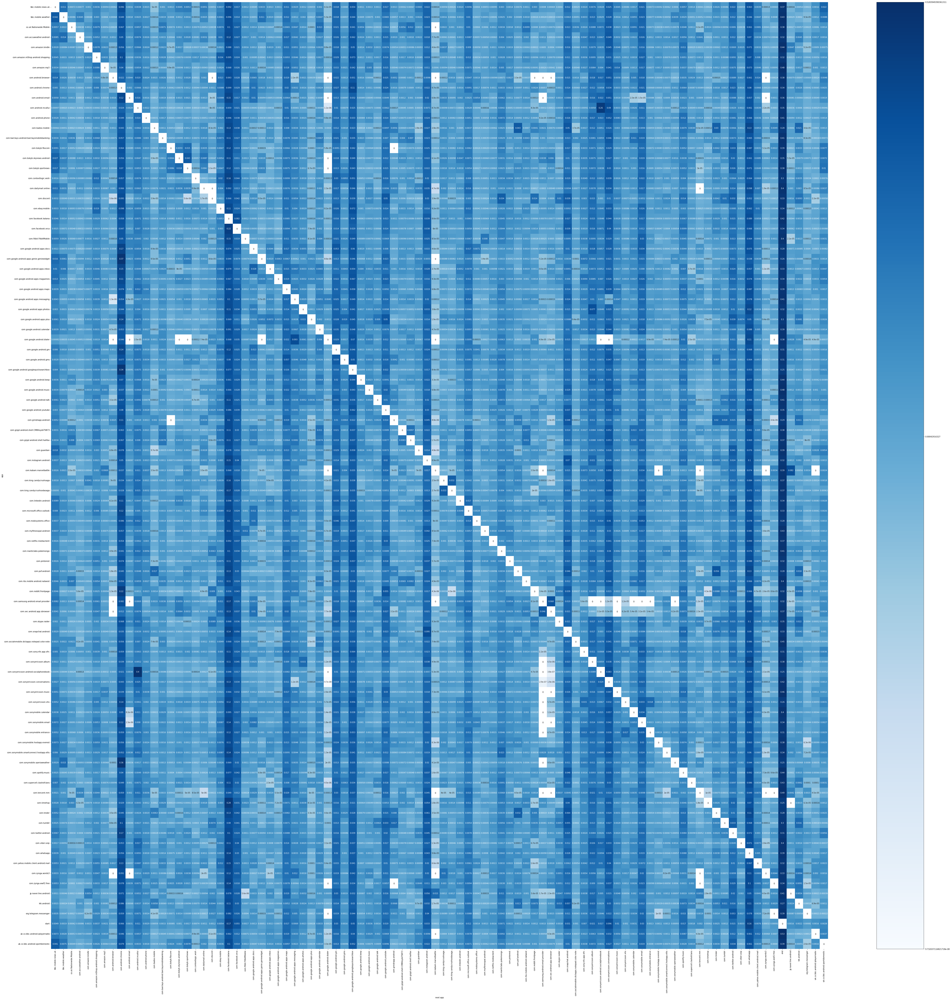

In [137]:
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(90,90))
sns.heatmap(
    np.where(df2.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df2, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df2,
    #ax=ax[0, 0],
    cbar=False,
    annot=Transaction_matrix_nomalized2,
    #fmt="",
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
cbar = ax.figure.colorbar(ax.collections[1], ticks=[-7.011796243391022,-3.36737744634,-0.2770413507077892])
cbar.ax.set_yticklabels(['9.732037116821718e-08','0.00042916327','0.5283949390361311'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length2_nomalized_matrix.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

### Start and End matrix group2

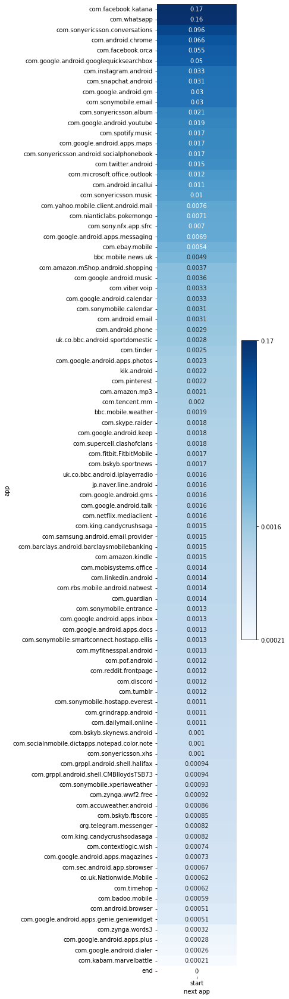

In [104]:
end = Transaction_matrix_nomalized2.loc[:,['end']]
start_row = Transaction_matrix_nomalized2.loc[['start'],:].T.sort_values(["start"], ascending=False)

#start_row = Transaction_matrix_nomalized.loc[['start'],:].T

start_row

fig, ax = plt.subplots(figsize=(3,30))
sns.heatmap(
    np.where(df2.loc[['start'],:].T.sort_values(["start"], ascending=False).isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df2.loc[['start'],:].T.sort_values(["start"], ascending=False), "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df2.loc[['start'],:].T.sort_values(["start"], ascending=False),
    #ax=ax[0, 0],
    cbar=False,
    annot=start_row,
    #fmt="",
    vmin=-3.671313, vmax=-0.77022,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
cbar = ax.figure.colorbar(ax.collections[1], ticks=[-3.671313,-2.573188,-0.77022])
cbar.ax.set_yticklabels(['0.00021','0.0016','0.17'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length2_nomalized_start.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()





In [108]:
np.min(df2.loc[:,['end']].sort_values(["end"]))

next_app
end   -0.608072
dtype: float64

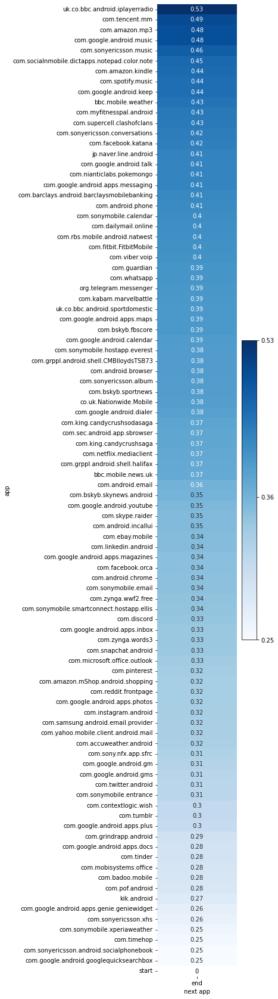

In [109]:
fig, ax = plt.subplots(figsize=(3,30))
sns.heatmap(
    np.where(df2.loc[:,['end']].sort_values(["end"], ascending=False).isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df2.loc[:,['end']].sort_values(["end"],ascending=False), "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df2.loc[:,['end']].sort_values(["end"],ascending=False),
    #ax=ax[0, 0],
    cbar=False,
    annot=Transaction_matrix_nomalized2.loc[:,['end']].sort_values(["end"],ascending=False),
    #fmt="",
    vmin=-0.608072, vmax=-0.277041,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
cbar = ax.figure.colorbar(ax.collections[1], ticks=[-0.608072,-0.450082,-0.277041])
cbar.ax.set_yticklabels(['0.25','0.36','0.53'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length2_nomalized_end.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()


## Highest frequent next app for group2

In [113]:
high_df = df2.loc[:,['com.android.chrome','com.facebook.katana','com.google.android.gm',
                     'com.google.android.apps.maps' ,'com.facebook.orca','com.google.android.googlequicksearchbox','com.google.android.youtube',
                    'com.instagram.android','com.snapchat.android','com.twitter.android','com.sonyericsson.conversations','com.whatsapp' ]]


In [114]:

high_norm = Transaction_matrix_nomalized2.loc[:,['com.android.chrome','com.facebook.katana','com.google.android.gm',
                     'com.google.android.apps.maps' ,'com.facebook.orca','com.google.android.googlequicksearchbox','com.google.android.youtube',
                    'com.instagram.android','com.snapchat.android','com.twitter.android','com.sonyericsson.conversations','com.whatsapp' ]]

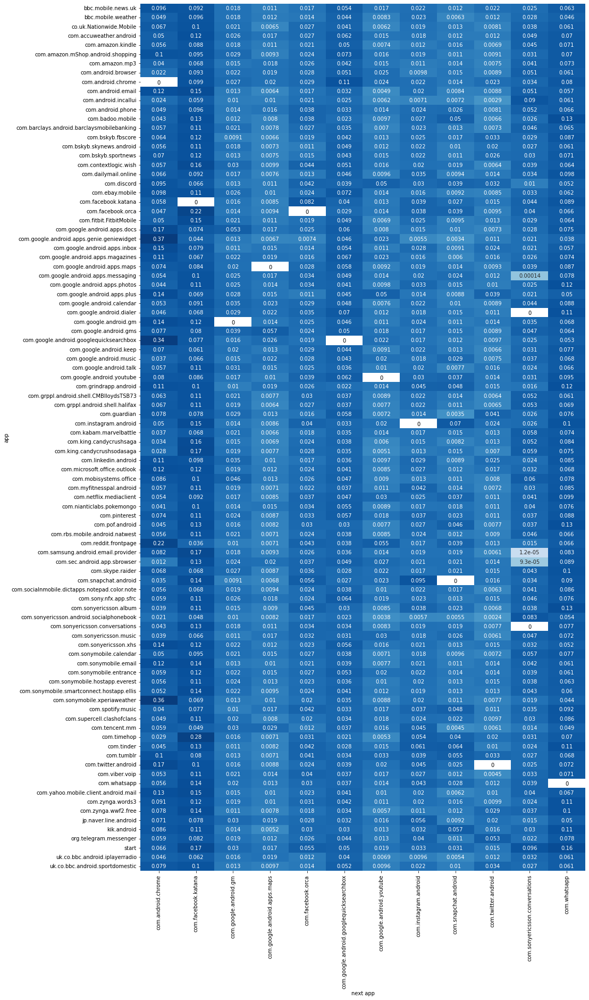

In [115]:

fig, ax = plt.subplots(figsize=(15,30))
sns.heatmap(
    np.where(high_df.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(high_df, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    high_df,
    #ax=ax[0, 0],
    cbar=False,
    annot=high_norm,
    #fmt="",
    vmin=-6.3839415084117785, vmax=-0.12877436113948487,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
#cbar = ax.figure.colorbar(ax.collections[1], ticks=[-6.3839415084117785,-2.570574812673693,-0.12877436113948487])
#cbar.ax.set_yticklabels(['4.131031357419725e-07','0.01202','0.7434'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length2_nomalized_high_next_app.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

 ## top and bottom 20 data for group2

In [76]:
Transaction_matrix2_nomalized_noend = Transaction_matrix_nomalized2.drop('end',1)

<ipython-input-76-3f8c55993b0e>:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only



In [77]:
Transaction_matrix2_nomalized_noend.stack().nlargest(20)

package_name                               next_app                                
com.sonyericsson.android.socialphonebook   com.android.incallui                        0.399138
com.google.android.apps.genie.geniewidget  com.android.chrome                          0.368607
com.sonymobile.xperiaweather               com.android.chrome                          0.360142
com.google.android.googlequicksearchbox    com.android.chrome                          0.342285
com.timehop                                com.facebook.katana                         0.279717
com.android.incallui                       com.sonyericsson.android.socialphonebook    0.257216
com.reddit.frontpage                       com.android.chrome                          0.219353
com.facebook.orca                          com.facebook.katana                         0.218677
com.samsung.android.email.provider         com.facebook.katana                         0.174845
com.king.candycrushsodasaga                com.faceb

In [78]:
df_small2 =Transaction_matrix2_nomalized_noend.replace(0,np.nan).stack().nsmallest(20)
df_small2.to_csv('smallest_table_group_two.csv')

In [79]:
df_small2

package_name                              next_app                          
com.sonyericsson.conversations            com.google.android.dialer             9.732037e-08
                                          com.samsung.android.email.provider    2.919611e-07
com.sonyericsson.android.socialphonebook  com.sec.android.app.sbrowser          3.786763e-07
com.android.incallui                      com.google.android.dialer             1.070272e-06
com.google.android.apps.messaging         com.android.browser                   1.282795e-06
com.sonymobile.email                      com.android.email                     1.539025e-06
com.sonyericsson.conversations            com.sec.android.app.sbrowser          1.946407e-06
com.reddit.frontpage                      com.kabam.marvelbattle                4.311609e-06
                                          com.king.candycrushsodasaga           4.311609e-06
                                          com.timehop                           4.3116

## Transition matrix for group with length bigger than 2 

In [16]:
data_length_other_session['start']=data_length_other_session.groupby('user_id').session.shift(1)!=data_length_other_session.session

data_length_other_session['end']=data_length_other_session.groupby('user_id').session.shift(-1)!=data_length_other_session.session

user_corpus_last_group=data_length_other_session.groupby(['user_id','session']).package_name.apply(' '.join)

user_corpus_with_start_end_last_group='start '+user_corpus_last_group+ ' end'

In [17]:
frequent_apps_without_start_end=set(freuqent_apps)
frequent_apps_without_start_end.remove("start")
frequent_apps_without_start_end.remove("end")

len(frequent_apps_without_start_end)

df_frequent_app_count = data_length_other_session[data_length_other_session.package_name.apply(lambda l : l in frequent_apps_without_start_end)].groupby(['package_name'])\
                            .agg({'session':'size'})\
                            .rename(columns={'session':'app_count'})

data_length_other_session['next_app'] = data_length_other_session.groupby(['user_id','session']).package_name.shift(-1).fillna("end")

df_next_app_count=data_length_other_session[data_length_other_session.package_name.isin(frequent_apps_without_start_end)].groupby(['package_name','next_app'])\
                            .agg({'session':'size'})\
                            .rename(columns = {'session':'next_count'})

frequent_apps_without_start=set(freuqent_apps)
frequent_apps_without_start.remove("start")

df_numerator = df_next_app_count[df_next_app_count.index.get_level_values('next_app')\
                                 .isin(frequent_apps_without_start)].reset_index()

df_frequent_app_count=df_frequent_app_count.append(pd.DataFrame(data_length_other_session.start.sum(),columns=['app_count'],index=['start']))

df_frequent_app_count=df_frequent_app_count.reset_index()

start_numerator=data_length_other_session[(data_length_other_session.start)&(data_length_other_session.package_name.isin(frequent_apps_without_start_end))].groupby(["package_name"]).agg({'session':'size'})\
                            .rename(columns = {'session':'next_count'}).reset_index().rename(columns = {'package_name':'next_app'})
start_numerator['package_name']='start'

df_numerator=df_numerator.append(start_numerator)

df_frequent_app_count=df_frequent_app_count.rename(columns={'index':'package_name'})

df_transaction_s3 = df_numerator.merge(df_frequent_app_count, on='package_name')

df_transaction_s3['probability'] =df_transaction_s3.next_count/df_transaction_s3.app_count

df_transaction_s3.drop(['next_count', 'app_count'], axis=1, inplace=True)

#Transaction_matrix = df_transaction.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

#Transaction_matrix=Transaction_matrix.fillna(0)


transitions_for_top3=df_transaction_s3[(df_transaction_s3.package_name.isin(set(freuqent_apps)))&(df_transaction_s3.next_app.isin(set(freuqent_apps)))]  
transitions_for_top3['probability']=transitions_for_top3.groupby('package_name').probability.transform(lambda x: x  / x.sum())

In [18]:
Transaction_matrix_nomalized3 = transitions_for_top3.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

Transaction_matrix_nomalized3=Transaction_matrix_nomalized3.fillna(0)

Transaction_matrix3 = df_transaction_s3.set_index(['package_name','next_app']).stack().unstack(level=1).droplevel(1)

Transaction_matrix3=Transaction_matrix3.fillna(0)

In [19]:
df3 = np.log10(Transaction_matrix_nomalized3)
df3 = df3.replace([np.inf, -np.inf], np.nan)

test3 = Transaction_matrix_nomalized3.replace([0], np.nan)

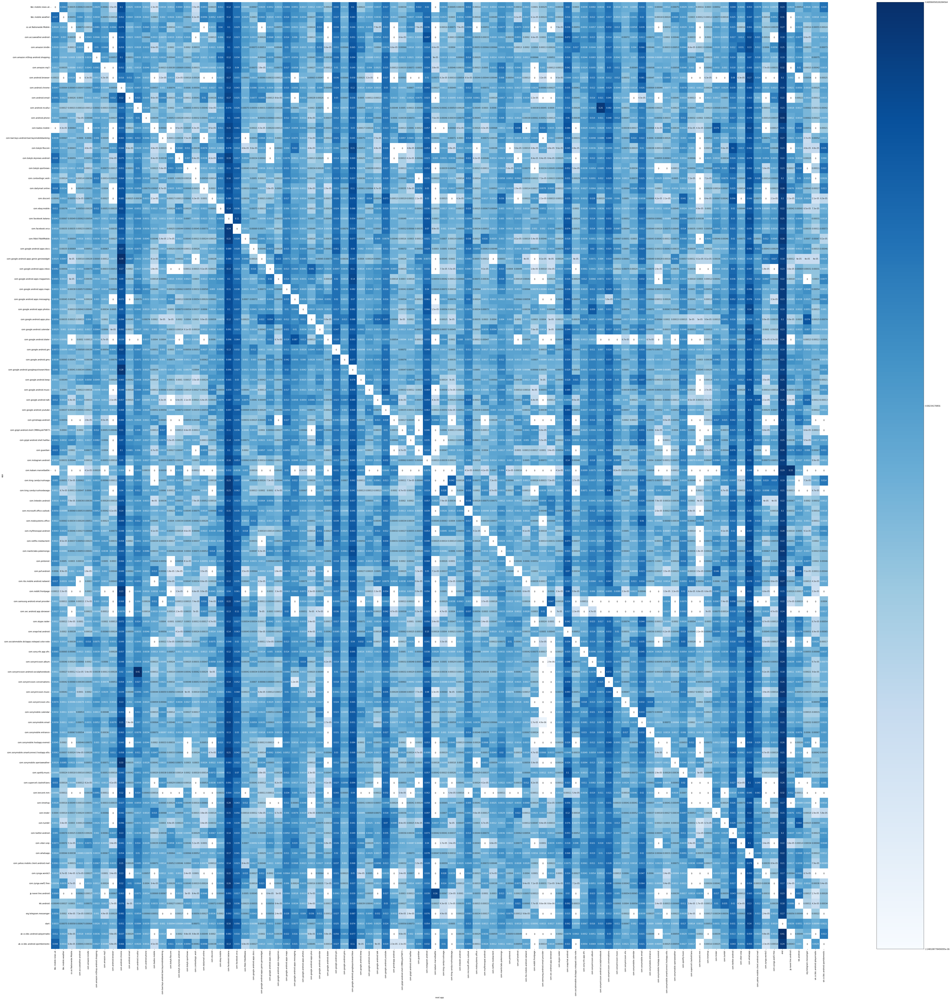

In [134]:
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(90,90))
sns.heatmap(
    np.where(df3.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df3, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df3,
    #ax=ax[0, 0],
    cbar=False,
    annot=Transaction_matrix_nomalized3,
    #fmt="",
    #annot_kws={"size": 10, "va": "center_baseline"},
    vmin=-5.648182678532229, vmax=-0.38724836594540063,
    cmap=sns.color_palette("Blues", as_cmap=True))
cbar = ax.figure.colorbar(ax.collections[1], ticks=[-5.648182678532229,-2.63046715629,-0.38724836594540063])
cbar.ax.set_yticklabels(['2.248108778490095e-06','0.00234170856','0.40996958100284564'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length3_nomalized.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

### Start and End matrix group3

In [139]:
end = Transaction_matrix_nomalized3.loc[:,['end']]
start_row = Transaction_matrix_nomalized3.loc[['start'],:].T.sort_values(["start"], ascending=False)

In [141]:
np.max(df3.loc[['start'],:].T.sort_values(["start"], ascending=False))

package_name
start   -0.795482
dtype: float64

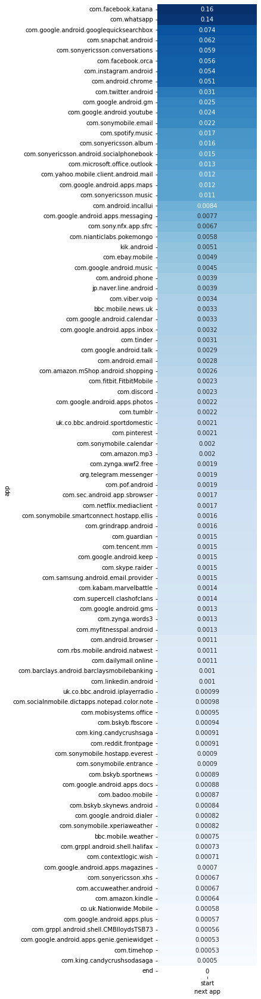

In [143]:
fig, ax = plt.subplots(figsize=(3,30))
sns.heatmap(
    np.where(df3.loc[['start'],:].T.sort_values(["start"], ascending=False).isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df3.loc[['start'],:].T.sort_values(["start"], ascending=False), "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df3.loc[['start'],:].T.sort_values(["start"], ascending=False),
    #ax=ax[0, 0],
    cbar=False,
    annot=start_row,
    #fmt="",
    #vmin=-3.303799, vmax=-0.795482,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
#cbar = ax.figure.colorbar(ax.collections[1], ticks=[-3.303799,-1.2541585,-0.795482])
#, ticks=[-6.3839415084117785,-2.570574812673693,-0.12877436113948487]
#cbar.ax.set_yticklabels(['4.131031357419725e-07','0.01202','0.7434'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length3_nomalized_start.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

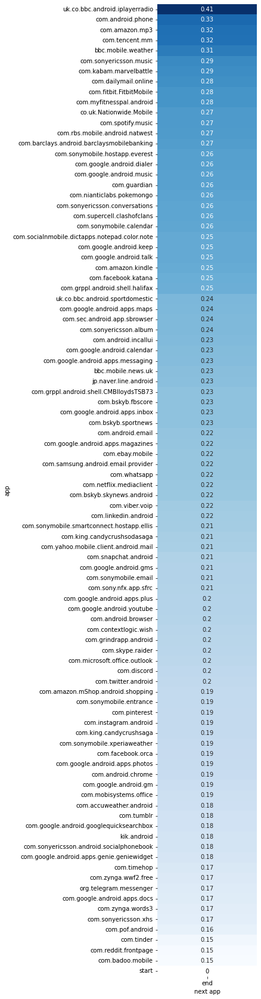

In [145]:
fig, ax = plt.subplots(figsize=(3,30))
sns.heatmap(
    np.where(df3.loc[:,['end']].sort_values(["end"], ascending=False).isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(df3.loc[:,['end']].sort_values(["end"],ascending=False), "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    df3.loc[:,['end']].sort_values(["end"],ascending=False),
    #ax=ax[0, 0],
    cbar=False,
    annot=Transaction_matrix_nomalized3.loc[:,['end']].sort_values(["end"],ascending=False),
    #fmt="",
    #vmin=-6.3839415084117785, vmax=-0.12877436113948487,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
#cbar = ax.figure.colorbar(ax.collections[1])
#, ticks=[-6.3839415084117785,-2.570574812673693,-0.12877436113948487]
#cbar.ax.set_yticklabels(['4.131031357419725e-07','0.01202','0.7434'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length3_nomalized_end.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

## Highest frequent next app for group3

In [146]:
high_df = df3.loc[:,['com.android.chrome','com.facebook.katana','com.google.android.gm',
                     'com.google.android.apps.maps' ,'com.facebook.orca','com.google.android.googlequicksearchbox','com.google.android.youtube',
                    'com.instagram.android','com.snapchat.android','com.twitter.android','com.sonyericsson.conversations','com.whatsapp' ]]



high_norm = Transaction_matrix_nomalized3.loc[:,['com.android.chrome','com.facebook.katana','com.google.android.gm',
                     'com.google.android.apps.maps' ,'com.facebook.orca','com.google.android.googlequicksearchbox','com.google.android.youtube',
                    'com.instagram.android','com.snapchat.android','com.twitter.android','com.sonyericsson.conversations','com.whatsapp' ]]


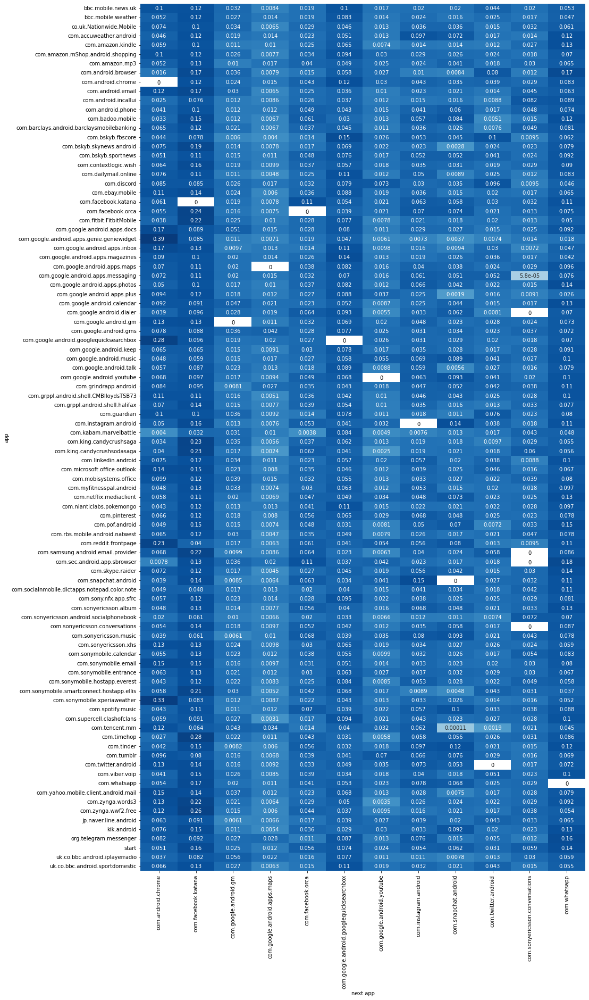

In [148]:

fig, ax = plt.subplots(figsize=(15,30))
sns.heatmap(
    np.where(high_df.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(high_df, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    cmap=ListedColormap(['none']))
    #linewidth=0)
sns.heatmap(
    high_df,
    #ax=ax[0, 0],
    cbar=False,
    annot=high_norm,
    #fmt="",
    vmin=-6.3839415084117785, vmax=-0.12877436113948487,
    #annot_kws={"size": 10, "va": "center_baseline"},
    cmap=sns.color_palette("Blues", as_cmap=True))
#cbar = ax.figure.colorbar(ax.collections[1], ticks=[-6.3839415084117785,-2.570574812673693,-0.12877436113948487])
#cbar.ax.set_yticklabels(['4.131031357419725e-07','0.01202','0.7434'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_output_length2_nomalized_high_next_app.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()


 ## top and bottom 20 data for group2

In [90]:

Transaction_matrix3_nomalized_noend = Transaction_matrix_nomalized3.drop('end',1)


<ipython-input-90-19fa7ea2d6c8>:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only



In [91]:
Transaction_matrix3_nomalized_noend.stack().nlargest(20)



package_name                               next_app                                
com.sonyericsson.android.socialphonebook   com.android.incallui                        0.405932
com.google.android.apps.genie.geniewidget  com.android.chrome                          0.391391
com.sonymobile.xperiaweather               com.android.chrome                          0.329273
com.kabam.marvelbattle                     jp.naver.line.android                       0.328609
com.google.android.googlequicksearchbox    com.android.chrome                          0.283565
com.timehop                                com.facebook.katana                         0.283264
com.android.incallui                       com.sonyericsson.android.socialphonebook    0.263465
com.zynga.wwf2.free                        com.facebook.katana                         0.255316
com.facebook.orca                          com.facebook.katana                         0.238345
com.king.candycrushsaga                    com.faceb

In [92]:
Transaction_matrix3_nomalized_noend.stack().nlargest(20)

package_name                               next_app                                
com.sonyericsson.android.socialphonebook   com.android.incallui                        0.405932
com.google.android.apps.genie.geniewidget  com.android.chrome                          0.391391
com.sonymobile.xperiaweather               com.android.chrome                          0.329273
com.kabam.marvelbattle                     jp.naver.line.android                       0.328609
com.google.android.googlequicksearchbox    com.android.chrome                          0.283565
com.timehop                                com.facebook.katana                         0.283264
com.android.incallui                       com.sonyericsson.android.socialphonebook    0.263465
com.zynga.wwf2.free                        com.facebook.katana                         0.255316
com.facebook.orca                          com.facebook.katana                         0.238345
com.king.candycrushsaga                    com.faceb

In [97]:
df_small3 =Transaction_matrix3_nomalized_noend.replace(0,np.nan).stack().nsmallest(20)
df_small3.to_csv('smallest_table_group_other.csv')

df_small3

package_name                    next_app                          
com.snapchat.android            com.tencent.mm                        0.000002
com.sonyericsson.album          com.sec.android.app.sbrowser          0.000003
com.sonymobile.email            com.samsung.android.email.provider    0.000005
                                com.android.email                     0.000007
kik.android                     com.samsung.android.email.provider    0.000009
                                com.sec.android.app.sbrowser          0.000009
com.sonyericsson.conversations  com.google.android.apps.messaging     0.000012
com.sonyericsson.music          com.kabam.marvelbattle                0.000013
com.google.android.apps.photos  com.kabam.marvelbattle                0.000015
jp.naver.line.android           uk.co.bbc.android.iplayerradio        0.000017
com.tumblr                      com.tencent.mm                        0.000017
com.viber.voip                  com.king.candycrushsaga         

## Comparision Matrix for pairs

### Comaprision for group1 wrt group2

In [28]:
dif12 = Transaction_matrix_nomalized - Transaction_matrix_nomalized2
dif12 = dif12.drop(['end'],axis=1)

In [30]:
np.amin(dif12.to_numpy())

-0.10671701143159952

/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:198: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:203: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


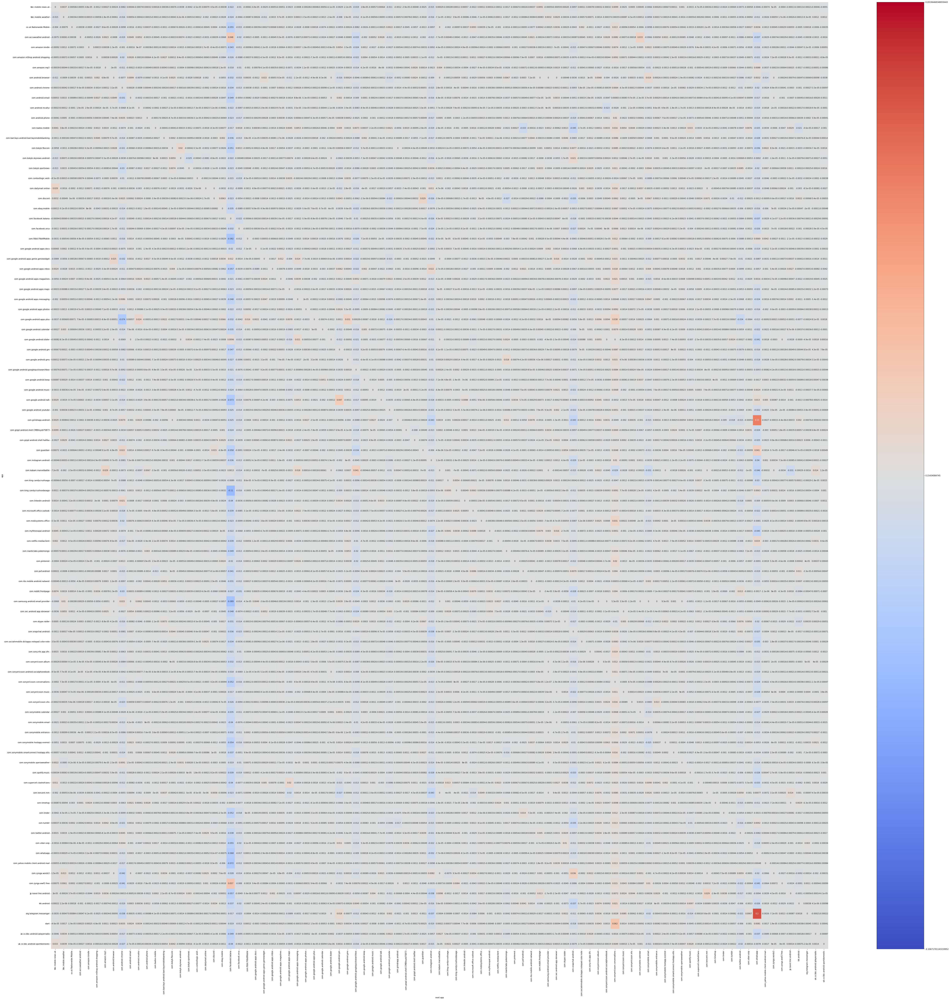

In [33]:
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(90,90))
sns.heatmap(
    np.where(dif12.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(dif12, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    
    cmap=ListedColormap(['white']))
    #linewidth=0)

sns.heatmap(
    dif12,
    #ax=ax[0, 0],
    cbar=False,
    annot=dif12,
    #fmt="",
    #annot_kws={"size": 10, "va": "center_baseline"},
    
    vmin=-0.25, vmax=0.25,
    cmap=sns.color_palette("coolwarm", as_cmap=True))
#viridis
cbar = ax.figure.colorbar(ax.collections[1],ticks=[-0.25,0,0.25])
cbar.ax.set_yticklabels(['-0.10671701143159952','0.15434084745','0.20196468348059443'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_comaprasion_g1_g2_ssession_length_transition_matrix_dif.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

Black cell stands for :
 1. 0 in both case
 2. not 0 in main case / 0
 
White stand for:
 1. 0 in main case / actual number in comparision case

## Comparasion between group1 wrt  group3
1. the difference between probablities instead of the division


In [23]:
dif13 = Transaction_matrix_nomalized-Transaction_matrix_nomalized3
dif13 = dif13.drop(['end'],axis=1)

In [26]:
np.min(dif13.values)

-0.27756600005554233

/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:198: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:203: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


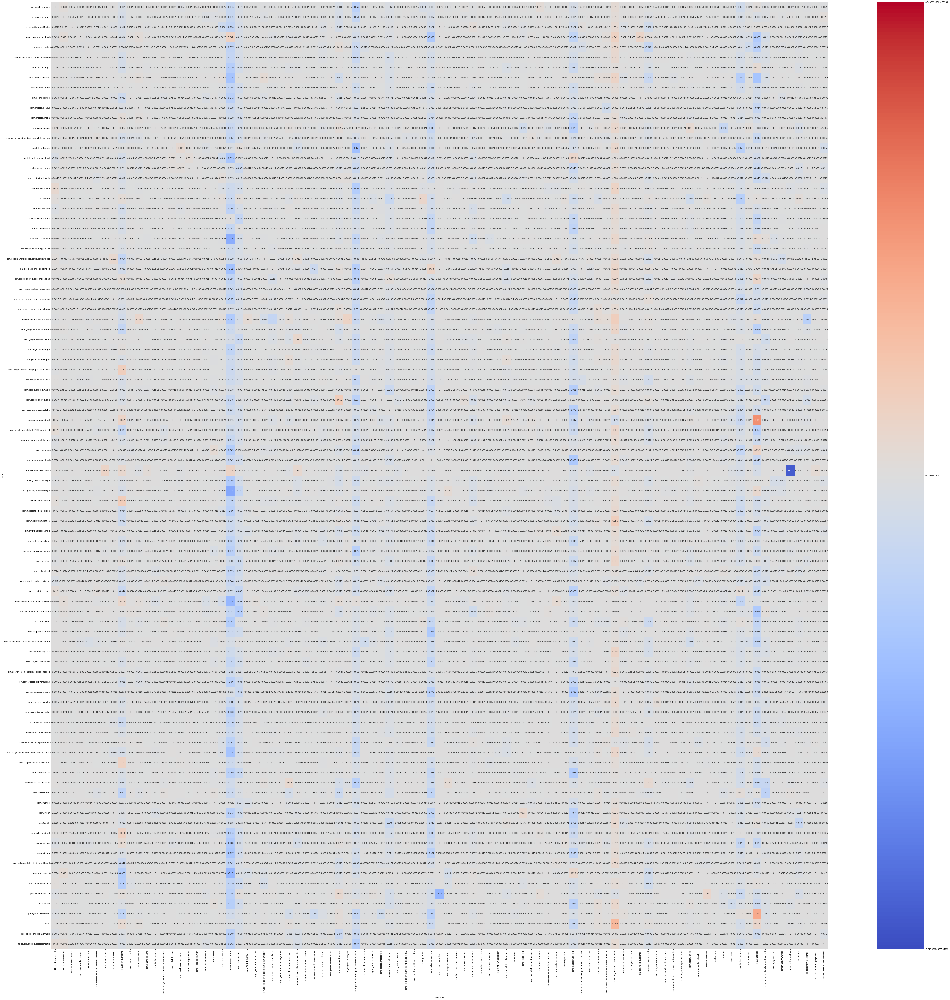

In [32]:
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(90,90))
sns.heatmap(
    np.where(dif13.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(dif13, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    
    cmap=ListedColormap(['white']))
    #linewidth=0)

sns.heatmap(
    dif13,
    #ax=ax[0, 0],
    cbar=False,
    annot=dif13,
    #fmt="",
    #annot_kws={"size": 10, "va": "center_baseline"},
    
    vmin=-0.3, vmax=0.3,
    cmap=sns.color_palette("coolwarm", as_cmap=True))
#viridis
cbar = ax.figure.colorbar(ax.collections[1],ticks=[-0.3,0,0.3])
cbar.ax.set_yticklabels(['-0.27756600005554233','0.22056579035','0.16356558065100185'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_comaprasion_g1_g3_ssession_length_transition_matrix_dif.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

## Compare high pro groups 

In [50]:
dif_comparision  = dif.loc[:,['com.android.chrome','com.facebook.katana','com.google.android.gm'
                      ,'com.facebook.orca','com.google.android.googlequicksearchbox',
                    'com.sonyericsson.conversations','com.whatsapp' ]]

## compare grp 2 wrt grp3

In [34]:
dif23 = Transaction_matrix_nomalized2-Transaction_matrix_nomalized3
dif23 = dif23.drop(['end'],axis=1)

In [37]:
np.amin(dif23.to_numpy())

-0.2462857599211236

/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:198: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:203: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


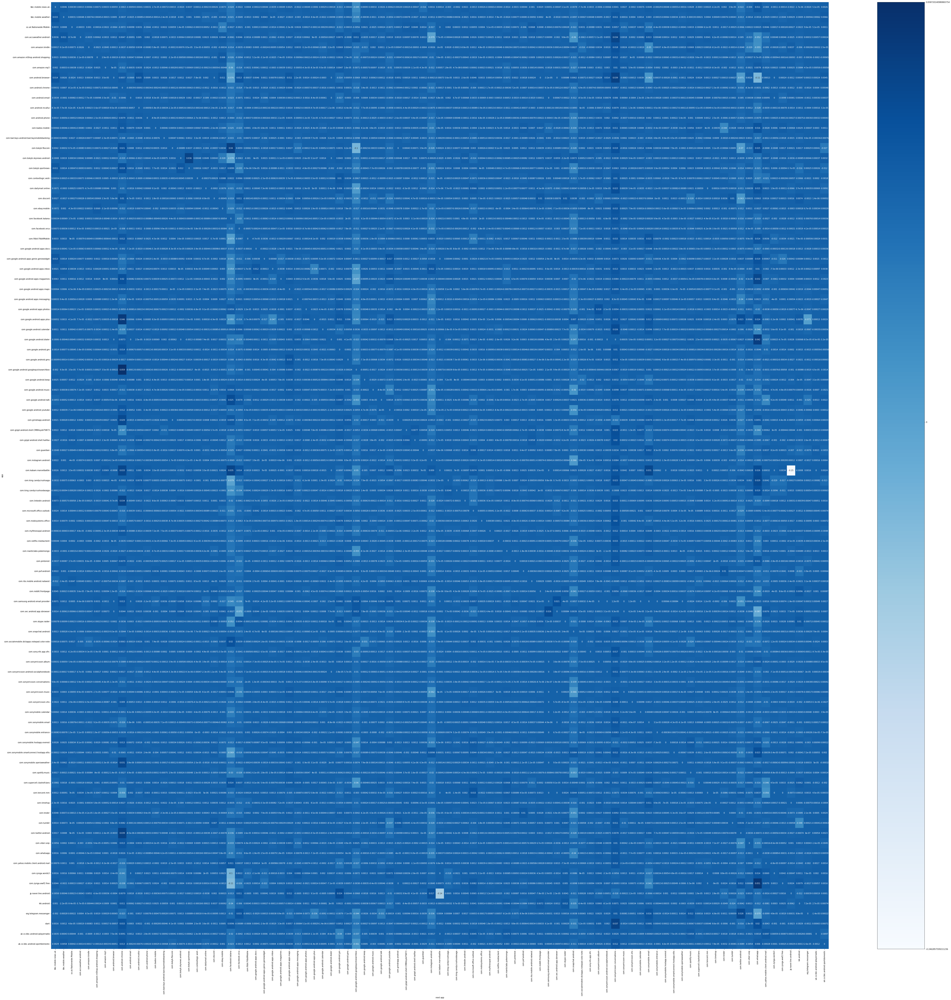

In [43]:
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(90,90))
sns.heatmap(
    np.where(dif23.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(dif23, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    
    cmap=ListedColormap(['white']))
    #linewidth=0)

sns.heatmap(
    dif23,
    #ax=ax[0, 0],
    cbar=False,
    annot=dif23,
    #fmt="",
    #annot_kws={"size": 10, "va": "center_baseline"},
    
    vmin=-0.25, vmax=0.06,
    cmap=sns.color_palette("Blues", as_cmap=True))
#viridis
cbar = ax.figure.colorbar(ax.collections[1],ticks=[-0.25,-0.0775,0.06])
cbar.ax.set_yticklabels(['-0.2462857599211236','0','0.058720140980865754'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_comaprasion_g2_g3_ssession_length_transition_matrix_dif.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

## Group one versus two

In [95]:
dif12 = Transaction_matrix_nomalized-Transaction_matrix_nomalized2
dif12 = dif12.drop(['end'],axis=1)

/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:198: RuntimeWarning:

All-NaN slice encountered

/home/s165317/.conda/envs/myenv/lib/python3.8/site-packages/seaborn/matrix.py:203: RuntimeWarning:

All-NaN slice encountered



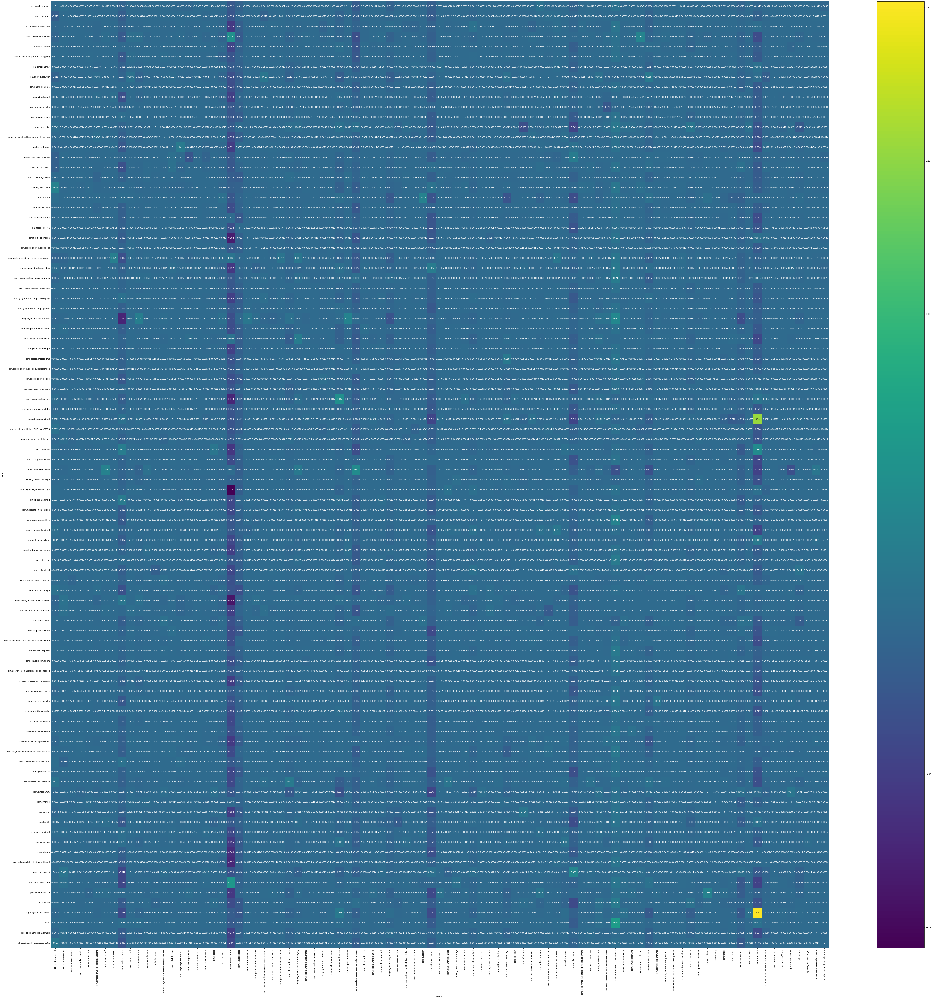

In [96]:
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(figsize=(90,90))
sns.heatmap(
    np.where(dif12.isna(), 0, np.nan),
    #ax=ax[0, 0],
    cbar=False,
    annot=np.full_like(dif12, "0", dtype=object),
    fmt="",
    annot_kws={"size": 10, "va": "center_baseline", "color": "black"},
    
    cmap=ListedColormap(['white']))
    #linewidth=0)

sns.heatmap(
    dif12,
    #ax=ax[0, 0],
    cbar=False,
    annot=dif12,
    #fmt="",
    #annot_kws={"size": 10, "va": "center_baseline"},
    
    #vmin=-0.5, vmax=0.5,
    cmap=sns.color_palette("viridis", as_cmap=True))
#viridis
cbar = ax.figure.colorbar(ax.collections[1])
#ticks=[-3.3041420242196113,-0.15180120099350852,2.364258888849043]
#cbar.ax.set_yticklabels(['0.0004964299509645064','0.00443','1406.5294952439397'])
ax.set(xlabel='next app')
ax.set(ylabel='app')
plt.savefig('logrithm_comaprasion_g1_g2_ssession_length_transition_matrix_dif.pdf'
             ,bbox_inches='tight', 
               transparent=True,
               pad_inches=3)
plt.show()

## Old version

In [48]:
g1_g3 = np.log10(Transaction_matrix_nomalized/Transaction_matrix_nomalized3)

In [49]:
g1_g3.replace([np.inf, -np.inf], np.nan, inplace=True)

In [51]:
npg1_g3 = g1_g3.to_numpy()
g1_g3_annotation=Transaction_matrix_nomalized/Transaction_matrix_nomalized3
np_g1_g3_annotation = g1_g3_annotation.to_numpy()

In [52]:
np.amin( g1_g3.fillna(10).to_numpy())   

-3.3041420242196113

In [53]:
np.mean(g1_g3.fillna(0).to_numpy())

-0.15180120099350852

In [54]:
np.amax(g1_g2.fillna(-10).to_numpy())   

2.364258888849043

In [55]:
np_g1_g3_annotation[~np.isnan(np_g1_g3_annotation)]

array([2.30442278, 0.41464532, 0.35833546, ..., 0.64017127, 0.15109632,
       1.05885471])

In [56]:
np.amax(np.nan_to_num(np_g1_g3_annotation[np.logical_not(np.isnan(np_g1_g3_annotation))],posinf=0, neginf=0) ) 

1406.5294952439397

In [57]:
np.mean( a[a < 1E308])

NameError: name 'a' is not defined

## Test Area

In [ ]:
Transaction_matrix_nomalized/Transaction_matrix_nomalized2

In [ ]:
g1_g2 = df/df2

In [ ]:
g1_g2.fillna(10)

In [ ]:
g1_g2.to_numpy()

In [ ]:
np.amin( g1_g2.fillna(10).to_numpy())   

In [ ]:
npg1_g2 = g1_g2.to_numpy()

In [ ]:
#npg1_g2[np.logical_not(np.isnan(npg1_g2))]
np.mean( g1_g2.fillna(0).to_numpy())

In [ ]:
np.amax( g1_g2.fillna(10).to_numpy())   

In [ ]:
g1_g2_annotation=Transaction_matrix_nomalized/Transaction_matrix_nomalized2
#npg1_g2_annotation = g1_g2_annotation.to_numpy()

In [ ]:
np.amin(g1_g2_annotation.fillna(10).to_numpy())

In [ ]:
np.amin( npg1_g2_annotation[np.logical_not(np.isnan(npg1_g2_annotation))])   

In [ ]:
np.mean(npg1_g2_annotation[np.logical_not(np.isnan(npg1_g2_annotation))])   

In [ ]:
np.amax(np.nan_to_num(npg1_g2_annotation[np.logical_not(np.isnan(npg1_g2_annotation))],posinf=0, neginf=0) )


In [ ]:
np.nan_to_num(npg1_g2_annotation[np.logical_not(np.isnan(npg1_g2_annotation))],posinf=0, neginf=0) 